# Midterm 2 (40 points)

## Thursday, October 17, 1530 - 1730

# John Ming Ngo, 30020834

Instructions: Complete all questions to the best of your abilities. Unlike your assignments, carefully commenting your code and providing evidence for testing is not required; you don't have time for that! Instead, spend your time coding, generating results, and discussing them. Take it easy!

In [93]:
import numpy as np
import matplotlib.pyplot as plt
import random

In the past few assignments, you have been considering random walks / Markov chains on a one-dimensional line. Your goal for this midterm is to simulate a walker on the $d$-dimensional hypercube. The $2^d$ sites of the hypercube are labeled by binary strings of length $d$. For example, the $d=3$ hypercube (otherwise known as a cube) has 8 sites, labeled 0 through 7, or better 000, 001, 010, 011, 100, 101, 110, and 111.

On each time step of the random walk / Markov chain, the walker can move randomly to another site by changing (only) one of the bit values in the string. So a walker at site 000 can hop to any in the set $\{001,010,100\}$, each with probability 1/3. Likewise a walker at site 001 can hop back to 000, or 'forward' to either 011 or 101, again each with probability 1/3; but the walker at site 001 can NOT hop directly to 111 or to 010, as these would require flipping two bits. Note that the hopping probabilities between any two sites in the $d$-dimensional hypercube are always $1/d$.

### 1 (10 points): Hypercube site labels as bit strings
Write a Python program to print out all the site labels of the $d$-dimensional hypercube as a $d$-bit integer, followed by its bit-string representation as a length-$d$ list. Show that it works for $d=5$.

### 2 (30 points): Markov chain on the hypercube

**(a) (10 points)** Using your bit-string representations of the site labels, write a Python program to construct the $2^d$-dimensional Markov chain transition matrix $T$, for arbitrary $d$, using the hopping rule above. 

**(b) (10 points)** With the walker starting at position $0$, or $00\cdots 0$ in binary, calculate the probabilities of the walker on the other sites after $m$ steps (on the order of $d$) of the Markov chain. Plot the probability distribution as a function of the (integer) site label, for various values of $5\leq d\leq 10$. Comment on the results.

**(c) (10 points)** Determine if the Markov chain on the hypercube allows for uniform mixing. If so, how does the mixing time scale with $d$ in the range $2\leq d\leq 10$? How does it scale with the number of sites in the hypercube? Compare qualitatively with the result for random walks on a one-dimensional lattice.

### 1 (10 points): Hypercube site labels as bit strings
Write a Python program to print out all the site labels of the $d$-dimensional hypercube as a $d$-bit integer, followed by its bit-string representation as a length-$d$ list. Show that it works for $d=5$.

In [94]:
#Q1 - Here we go. Wait what is a d-bit integer?
import numpy as np
import matplotlib.pyplot as plt
import numpy.random as rand

def nDimLst(d):
    n = int(2**d)
    locs = []
    vals = []
    length = len(np.binary_repr((n-1)))
    for pos in range(n):
        res = strToLst(np.binary_repr(pos, width = length))
        vals.append(pos)
        locs.append(res)
    return vals, locs, zip(vals, locs)

def strToLst(aStr):
    lst = []
    for char in aStr:
        lst.append(int(char))
    return lst

In [95]:
#Works for d = 5
d = 5

print("Here's how this works for d = 5")
vals, locs, grouped = nDimLst(d)
for val, loc in grouped:
    print("Value (side): {} || Bit Representation: {}".format(val, loc))

Here's how this works for d = 5
Value (side): 0 || Bit Representation: [0, 0, 0, 0, 0]
Value (side): 1 || Bit Representation: [0, 0, 0, 0, 1]
Value (side): 2 || Bit Representation: [0, 0, 0, 1, 0]
Value (side): 3 || Bit Representation: [0, 0, 0, 1, 1]
Value (side): 4 || Bit Representation: [0, 0, 1, 0, 0]
Value (side): 5 || Bit Representation: [0, 0, 1, 0, 1]
Value (side): 6 || Bit Representation: [0, 0, 1, 1, 0]
Value (side): 7 || Bit Representation: [0, 0, 1, 1, 1]
Value (side): 8 || Bit Representation: [0, 1, 0, 0, 0]
Value (side): 9 || Bit Representation: [0, 1, 0, 0, 1]
Value (side): 10 || Bit Representation: [0, 1, 0, 1, 0]
Value (side): 11 || Bit Representation: [0, 1, 0, 1, 1]
Value (side): 12 || Bit Representation: [0, 1, 1, 0, 0]
Value (side): 13 || Bit Representation: [0, 1, 1, 0, 1]
Value (side): 14 || Bit Representation: [0, 1, 1, 1, 0]
Value (side): 15 || Bit Representation: [0, 1, 1, 1, 1]
Value (side): 16 || Bit Representation: [1, 0, 0, 0, 0]
Value (side): 17 || Bit Re

### 2 (30 points): Markov chain on the hypercube

**(a) (10 points)** Using your bit-string representations of the site labels, write a Python program to construct the $2^d$-dimensional Markov chain transition matrix $T$, for arbitrary $d$, using the hopping rule above. 

**(b) (10 points)** With the walker starting at position $0$, or $00\cdots 0$ in binary, calculate the probabilities of the walker on the other sites after $m$ steps (on the order of $d$) of the Markov chain. Plot the probability distribution as a function of the (integer) site label, for various values of $5\leq d\leq 10$. Comment on the results.

**(c) (10 points)** Determine if the Markov chain on the hypercube allows for uniform mixing. If so, how does the mixing time scale with $d$ in the range $2\leq d\leq 10$? How does it scale with the number of sites in the hypercube? Compare qualitatively with the result for random walks on a one-dimensional lattice.

**(a) (10 points)** Using your bit-string representations of the site labels, write a Python program to construct the $2^d$-dimensional Markov chain transition matrix $T$, for arbitrary $d$, using the hopping rule above. 

In [96]:
#Question 2a.
def genDTMat(d):
    matrix = []
    n = int(2**d)
    
    #Get how our sides are labelled.
    val, rep, combined = nDimLst(d)
    
    
    for i in range(n):
        row = [1/d]*n
        
        #I ain't coming back to myself! I ain't that drunk.
        row[i] = 0
        
        currentPos = rep[i]
        for j in range(len(row)):
            checkPos = rep[j]
            
            #If the side corrisponding to this index requires us to change more than 1 bit, 
            #well, screw this site it don't exist to me. I only go to 1 bit change sites.
            difference = 0
            for k in range(len(checkPos)):
                difference += abs(currentPos[k] - checkPos[k])
            if difference > 1:
                row[j] = 0
                
                
        matrix.append(row)
    return np.array(matrix)

In [97]:
print(genDTMat(2))

[[0.  0.5 0.5 0. ]
 [0.5 0.  0.  0.5]
 [0.5 0.  0.  0.5]
 [0.  0.5 0.5 0. ]]


In [98]:
res = genDTMat(4)
for row in res:
    print("|", end = "")
    for entry in row:
        print(entry, end = " ")
    print("|", end = "")
    print()

|0.0 0.25 0.25 0.0 0.25 0.0 0.0 0.0 0.25 0.0 0.0 0.0 0.0 0.0 0.0 0.0 |
|0.25 0.0 0.0 0.25 0.0 0.25 0.0 0.0 0.0 0.25 0.0 0.0 0.0 0.0 0.0 0.0 |
|0.25 0.0 0.0 0.25 0.0 0.0 0.25 0.0 0.0 0.0 0.25 0.0 0.0 0.0 0.0 0.0 |
|0.0 0.25 0.25 0.0 0.0 0.0 0.0 0.25 0.0 0.0 0.0 0.25 0.0 0.0 0.0 0.0 |
|0.25 0.0 0.0 0.0 0.0 0.25 0.25 0.0 0.0 0.0 0.0 0.0 0.25 0.0 0.0 0.0 |
|0.0 0.25 0.0 0.0 0.25 0.0 0.0 0.25 0.0 0.0 0.0 0.0 0.0 0.25 0.0 0.0 |
|0.0 0.0 0.25 0.0 0.25 0.0 0.0 0.25 0.0 0.0 0.0 0.0 0.0 0.0 0.25 0.0 |
|0.0 0.0 0.0 0.25 0.0 0.25 0.25 0.0 0.0 0.0 0.0 0.0 0.0 0.0 0.0 0.25 |
|0.25 0.0 0.0 0.0 0.0 0.0 0.0 0.0 0.0 0.25 0.25 0.0 0.25 0.0 0.0 0.0 |
|0.0 0.25 0.0 0.0 0.0 0.0 0.0 0.0 0.25 0.0 0.0 0.25 0.0 0.25 0.0 0.0 |
|0.0 0.0 0.25 0.0 0.0 0.0 0.0 0.0 0.25 0.0 0.0 0.25 0.0 0.0 0.25 0.0 |
|0.0 0.0 0.0 0.25 0.0 0.0 0.0 0.0 0.0 0.25 0.25 0.0 0.0 0.0 0.0 0.25 |
|0.0 0.0 0.0 0.0 0.25 0.0 0.0 0.0 0.25 0.0 0.0 0.0 0.0 0.25 0.25 0.0 |
|0.0 0.0 0.0 0.0 0.0 0.25 0.0 0.0 0.0 0.25 0.0 0.0 0.25 0.0 0.0 0.25 |
|0.0 0

In [99]:
##Yeah ok, that looks aboot right too me

#### Here it is. Each index in an input vector corrisponds with the probability of seeing the given side with label equal to the index, when we implement this rule we get this sort of matrix.

**(b) (10 points)** With the walker starting at position $0$, or $00\cdots 0$ in binary, calculate the probabilities of the walker on the other sites after $m$ steps (on the order of $d$) of the Markov chain. Plot the probability distribution as a function of the (integer) site label, for various values of $5\leq d\leq 10$. Comment on the results.

In [100]:
#Pos is a vector indicating the probability of the walker being on a given site.
"""
Look, gimme a site and I'll give ya its vec rep, 
This is probability one on the vec[site]. Site 1? vec[1] = [1, 0....]. How about it?
"""
def intToVec(val, d):
    n = int(2**d)
    row = np.zeros(n)
    row[val] = 1
    return np.array(row)

"""
Ya wanna shove the vec rep through that hypercube matrix?
Sure, tell me how many times ya wanna do it, an' how biggie
this cubie is anyways. 
"""
def doMTStep(pos, d, m):
    mat = genDTMat(d)
    pos1 = pos
    for i in range(m):
        pos1 = np.dot(mat, pos1)
    return pos1

In [101]:
#Makin' sure this is a thingy.
np.zeros(10)

array([0., 0., 0., 0., 0., 0., 0., 0., 0., 0.])

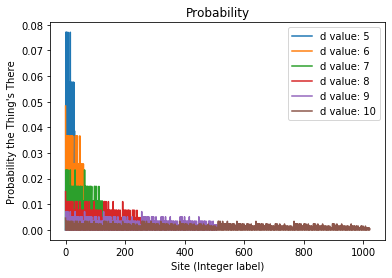

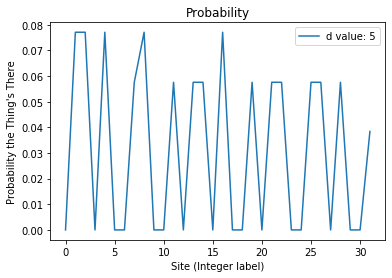

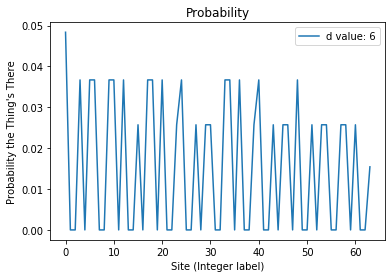

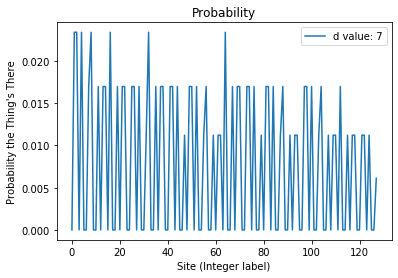

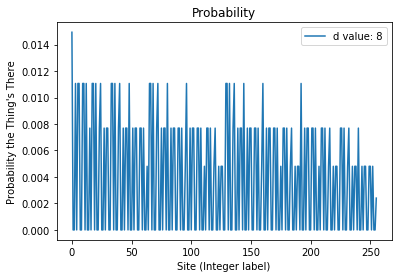

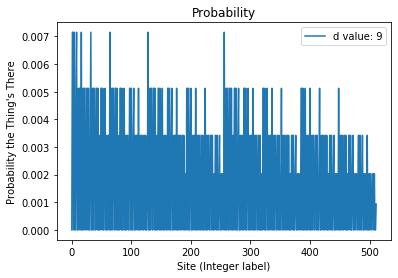

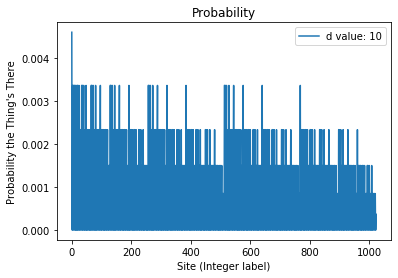

In [102]:
val = 0
d = [x for x in range(5, 11)]

#m = 10
"""
Look, order d for m, right? I got'tcha. I'll just shove in d! D is order D, ain't I right?
"""

vecVal = []
for a in d:
    vecVal.append(intToVec(val, a))

probs = []
for i in range(len(vecVal)):
    res = doMTStep(vecVal[i], d[i], d[i])
    probs.append(res)
    
#print(probs)

Xs = []
for a in d:
    Xs.append([x for x in range(2**a)])

plt.title("Probability")
for i in range(len(Xs)):
    plt.plot(Xs[i], probs[i], label = "d value: {}".format(d[i]))
plt.xlabel("Site (Integer label)")
plt.ylabel("Probability the Thing's There")
plt.legend()
    
for i in range(len(Xs)):
    plt.figure()
    plt.title("Probability")
    plt.plot(Xs[i], probs[i], label = "d value: {}".format(d[i]))
    plt.xlabel("Site (Integer label)")
    plt.ylabel("Probability the Thing's There")
    plt.legend()

#### From the individual graph of one of the first d values, I can see two saliennt features. First, it doesn't have probability for every single site n after that many iterations, but rather drops to zero conspicuously at multiple sites. Furthermore, you can sorta classify each  site that has probability into three different 'levels', where all the sites at the same level share the same very discrete probability. Finally, the results are rather... rectangular. Which is to say, there's no obvious bias towards the probabilities staying clumped together, even for these few transitions. This is likely due to not reaching a sort of equilibrium mixing state yet, but with the drops to zero, this also strongly implies that this thing won't evenly mix, if no probability flows into some of the sites at all.

#### From the very big graph, there's one major salient charecteristic I can see. Namely, it looks like an exponential decay graph; as d gets larger the amount of probability at any given site seems to spread exponentially. Given that the number of possible sites increases exponentially with d, and that total probability is fixed, however... this is like the pot calling the kettle black, or looking in the mirror.

**(c) (10 points)** Determine if the Markov chain on the hypercube allows for uniform mixing. If so, how does the mixing time scale with $d$ in the range $2\leq d\leq 10$? How does it scale with the number of sites in the hypercube? Compare qualitatively with the result for random walks on a one-dimensional lattice.

In [103]:
"""
If the only eigenvalue is a 1, and everything else is smaller than a 1, it can steady state mix.
"""
eigVals, eigVecs = np.linalg.eig(genDTMat(2))
print(eigVals)

[-1.00000000e+00  3.29868511e-17  1.00000000e+00  0.00000000e+00]


In [104]:
"""
Hold up! Two 1s? One of em' negative? 
Normally I'd say that this goes to some steady state, 
but I ain't seen a negative 1 and 2 1s before. I gotta
check this out more.
"""
ds = [x for x in range(2,11)]
for entry in ds:
    eigVals, eigVecs = np.linalg.eig(genDTMat(entry))
    print(eigVals) 

[-1.00000000e+00  3.29868511e-17  1.00000000e+00  0.00000000e+00]
[-1.          1.         -0.33333333  0.33333333 -0.33333333 -0.33333333
  0.33333333  0.33333333]
[-1.00000000e+00+0.00000000e+00j  1.00000000e+00+0.00000000e+00j
  5.00000000e-01+0.00000000e+00j -5.00000000e-01+0.00000000e+00j
 -5.00000000e-01+0.00000000e+00j -2.11065471e-17+7.59570514e-18j
 -2.11065471e-17-7.59570514e-18j  5.00000000e-01+0.00000000e+00j
  5.00000000e-01+0.00000000e+00j -3.66316285e-17+0.00000000e+00j
 -5.00000000e-01+0.00000000e+00j  5.00000000e-01+0.00000000e+00j
 -5.00000000e-01+0.00000000e+00j -5.92160571e-18+0.00000000e+00j
 -3.36067331e-17+2.33374920e-17j -3.36067331e-17-2.33374920e-17j]
[-1.   1.   0.6 -0.6  0.2  0.6  0.2 -0.2 -0.2  0.2 -0.2  0.6  0.6 -0.6
 -0.6 -0.6  0.6 -0.6  0.2 -0.2 -0.2 -0.2  0.2  0.2  0.2 -0.2 -0.2 -0.2
  0.2  0.2 -0.2  0.2]
[ 1.00000000e+00+0.00000000e+00j -1.00000000e+00+0.00000000e+00j
 -5.78675231e-18+0.00000000e+00j  6.66666667e-01+0.00000000e+00j
  6.66666667e-01+0.0

[-1.        +0.00000000e+00j  1.        +0.00000000e+00j
 -0.77777778+0.00000000e+00j -0.77777778+0.00000000e+00j
  0.77777778+0.00000000e+00j  0.77777778+0.00000000e+00j
  0.77777778+0.00000000e+00j -0.77777778+0.00000000e+00j
 -0.77777778+0.00000000e+00j -0.77777778+0.00000000e+00j
  0.77777778+0.00000000e+00j  0.77777778+0.00000000e+00j
 -0.77777778+0.00000000e+00j  0.77777778+0.00000000e+00j
  0.55555556+0.00000000e+00j -0.55555556+0.00000000e+00j
 -0.55555556+0.00000000e+00j -0.55555556+0.00000000e+00j
 -0.55555556+0.00000000e+00j -0.55555556+0.00000000e+00j
 -0.55555556+0.00000000e+00j  0.55555556+0.00000000e+00j
  0.55555556+0.00000000e+00j  0.55555556+0.00000000e+00j
  0.55555556+0.00000000e+00j  0.55555556+0.00000000e+00j
  0.33333333+0.00000000e+00j -0.33333333+0.00000000e+00j
 -0.33333333+0.00000000e+00j -0.33333333+0.00000000e+00j
 -0.33333333+0.00000000e+00j  0.33333333+0.00000000e+00j
  0.33333333+0.00000000e+00j  0.33333333+0.00000000e+00j
  0.33333333+0.00000000e+00j  0

[ 1. +0.j -1. +0.j -0.8+0.j ...  0.2+0.j -0.2+0.j  0.2+0.j]


##### It happens to them all! ALL of them have a 1... and a -1. I don't think it will even mix.


### Update: If I'm not mistake, a -1 in the eigenvalues implies that as this thing goes to infinity, it will constantly oscillate between two possible matrixes every time you throw another of itself at it. This is exactly what we get here. That is, the -1 Eigenvalue is exactly what prevents us from having uniform mixing. 

In [105]:
"""
Let's give it a go anyways.
"""

def findMixTime(d, epsilon):
    mat = genDTMat(d)
    n = int(2**d)
    evenMix = np.array([1/n]*n)
    changer = intToVec(0, d)
    i = 0
    while (np.sum(np.abs(changer-evenMix)) > epsilon):
        changer = np.dot(mat, changer)
        print(changer)
    return i

In [106]:
print(findMixTime(3, 1e-2))

[0.         0.33333333 0.33333333 0.         0.33333333 0.
 0.         0.        ]
[0.33333333 0.         0.         0.22222222 0.         0.22222222
 0.22222222 0.        ]
[0.         0.25925926 0.25925926 0.         0.25925926 0.
 0.         0.22222222]
[0.25925926 0.         0.         0.24691358 0.         0.24691358
 0.24691358 0.        ]
[0.         0.25102881 0.25102881 0.         0.25102881 0.
 0.         0.24691358]
[0.25102881 0.         0.         0.24965706 0.         0.24965706
 0.24965706 0.        ]
[0.         0.25011431 0.25011431 0.         0.25011431 0.
 0.         0.24965706]
[0.25011431 0.         0.         0.2499619  0.         0.2499619
 0.2499619  0.        ]
[0.        0.2500127 0.2500127 0.        0.2500127 0.        0.
 0.2499619]
[0.2500127  0.         0.         0.24999577 0.         0.24999577
 0.24999577 0.        ]
[0.         0.25000141 0.25000141 0.         0.25000141 0.
 0.         0.24999577]
[0.25000141 0.         0.         0.24999953 0.        

[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0. 

[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.2

[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0. 

[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.2

[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0. 

[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0. 

[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.2

[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.2

[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0. 

[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0. 

[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0. 

[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.2

[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0. 

[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0. 

[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.2

[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0. 

[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0. 

[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.2

[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.2

[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0. 

[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0. 

[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.2

[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0. 

[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0. 

[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.2

[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0. 

[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.2

[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0. 

[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.2

[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.2

[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.2

[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0. 

[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.2

[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0. 

[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0. 

[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.2

[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0. 

[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.2

[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.2

[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0. 

[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0. 

[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.2

[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.2

[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0. 

[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0. 

[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.2

[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.2

[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0. 

[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0. 

[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0. 

[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0. 

[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0. 

[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0. 

[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0. 

[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.2

[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.2

[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0. 

[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.2

[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0. 

[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.2

[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.2

[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.2

[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.2

[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.2

[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.2

[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0. 

[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.2

[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0. 

[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0. 

[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.2

[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0. 

[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.2

[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.2

[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0. 

[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.2

[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0. 

[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.2

[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.2

[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0. 

[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0. 

[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.2

[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0. 

[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.2

[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0. 

[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0. 

[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.2

[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.2

[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.2

[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.2

[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0. 

[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0. 

[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0. 

[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.2

[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.2

[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.2

[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.2

[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0. 

[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.2

[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.2

[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0. 

[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.2

[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0. 

[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.2

[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0. 

[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.2

[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0. 

[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0. 

[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0. 

[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0. 

[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.2

[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.2

[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.2

[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.2

[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0. 

[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0. 

[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0. 

[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.2

[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.2

[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0. 

[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.2

[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0. 

[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0. 

[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.2

[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0. 

[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.2

[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.2

[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.2

[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.2

[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0. 

[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.2

[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0. 

[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.2

[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.2

[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.2

[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.2

[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0. 

[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0. 

[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.2

[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0. 

[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.2

[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.2

[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.2

[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.2

[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0. 

[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.2

[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.2

[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.2

[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0. 

[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.2

[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0. 

[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.2

[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0. 

[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.2

[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0. 

[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0. 

[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0. 

[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0. 

[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0. 

[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0. 

[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.2

[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.2

[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0. 

[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0. 

[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0. 

[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.2

[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.2

[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0. 

[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0. 

[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0. 

[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.2

[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0. 

[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.2

[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0. 

[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0. 

[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.2

[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0. 

[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0. 

[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.2

[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0. 

[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0. 

[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0. 

[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0. 

[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0. 

[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0. 

[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.2

[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0. 

[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.2

[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.2

[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0. 

[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.2

[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.2

[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.2

[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0. 

[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.2

[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0. 

[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0. 

[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.2

[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0. 

[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0. 

[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0. 

[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0. 

[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.2

[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0. 

[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0. 

[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0. 

[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.2

[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0. 

[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0. 

[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0. 

[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0. 

[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0. 

[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0. 

[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.2

[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0. 

[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.2

[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.2

[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0. 

[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.2

[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.2

[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.2

[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0. 

[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0. 

[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0. 

[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.2

[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.2

[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.2

[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.2

[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.2

[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0. 

[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0. 

[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0. 

[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.2

[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0. 

[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.2

[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0. 

[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.2

[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0. 

[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0. 

[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.2

[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.2

[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0. 

[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0. 

[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.2

[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.2

[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0. 

[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0. 

[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0. 

[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.2

[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0. 

[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0. 

[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0. 

[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0. 

[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.2

[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0. 

[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.2

[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.2

[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.2

[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0. 

[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.2

[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0. 

[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.2

[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.2

[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.2

[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0. 

[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0. 

[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0. 

[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0. 

[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.2

[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.2

[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.2

[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.2

[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.2

[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.2

[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0. 

[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0. 

[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.2

[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0. 

[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0. 

[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.2

[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0. 

[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0. 

[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.2

[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0. 

[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0. 

[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0. 

[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0. 

[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.2

[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.2

[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.2

[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.2

[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0. 

[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0. 

[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.2

[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0. 

[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.2

[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0. 

[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0. 

[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0. 

[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.2

[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.2

[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0. 

[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.2

[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0. 

[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0. 

[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0. 

[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.2

[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.2

[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0. 

[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0. 

[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0. 

[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0. 

[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0. 

[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0. 

[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.2

[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.2

[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0. 

[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0. 

[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.2

[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.2

[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.2

[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.2

[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0. 

[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.2

[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0. 

[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.2

[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0. 

[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.2

[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.2

[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.2

[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0. 

[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0. 

[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0. 

[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0. 

[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0. 

[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0. 

[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.2

[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0. 

[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.2

[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0. 

[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.2

[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0. 

[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0. 

[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.2

[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0. 

[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.2

[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0. 

[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.2

[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0. 

[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0. 

[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.2

[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0. 

[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0. 

[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.2

[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.2

[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0. 

[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.2

[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0. 

[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.2

[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0. 

[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0. 

[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.2

[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.2

[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0. 

[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0. 

[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.2

[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.2

[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0. 

[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.2

[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.2

[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0. 

[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0. 

[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.2

[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0. 

[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.2

[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0. 

[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.2

[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.2

[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.2

[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.2

[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.2

[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.2

[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0. 

[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.2

[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.2

[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.2

[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.2

[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0. 

[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.2

[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0. 

[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.2

[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.2

[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.2

[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0. 

[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0. 

[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.2

[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0. 

[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.2

[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0. 

[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.2

[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0. 

[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.2

[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.2

[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0. 

[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.2

[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.2

[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0. 

[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0. 

[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0. 

[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0. 

[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0. 

[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0. 

[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0. 

[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0. 

[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.2

[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.2

[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.2

[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.2

[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.2

[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.2

[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0. 

[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.2

[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.2

[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0. 

[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0. 

[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0. 

[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.2

[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0. 

[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.2

[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0. 

[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.2

[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.2

[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0. 

[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0. 

[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0. 

[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.2

[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.2

[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.2

[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.2

[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0. 

[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0. 

[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0. 

[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0. 

[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.2

[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.2

[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.2

[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0. 

[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.2

[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0. 

[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0. 

[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0. 

[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0. 

[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0. 

[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0. 

[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.2

[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.2

[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.2

[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.2

[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.2

[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0. 

[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0. 

[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0. 

[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0. 

[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0. 

[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0. 

[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0. 

[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.2

[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0. 

[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.2

[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.2

[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.2

[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.2

[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.2

[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0. 

[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.2

[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0. 

[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.2

[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.2

[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.2

[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0. 

[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0. 

[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.2

[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.2

[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0. 

[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0. 

[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0. 

[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0. 

[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0. 

[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.2

[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.2

[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0. 

[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.2

[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0. 

[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.2

[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.2

[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0. 

[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.2

[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.2

[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.2

[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0. 

[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0. 

[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0. 

[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0. 

[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.2

[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0. 

[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.2

[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0. 

[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0. 

[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0. 

[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0. 

[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0. 

[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.2

[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0. 

[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0. 

[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0. 

[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0. 

[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0. 

[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.2

[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.2

[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0. 

[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0. 

[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0. 

[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0. 

[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0. 

[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0. 

[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.2

[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.2

[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.2

[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.2

[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.2

[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0. 

[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0. 

[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.2

[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.2

[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.2

[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0. 

[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0. 

[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.2

[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.2

[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.2

[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.2

[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0. 

[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.2

[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0. 

[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0. 

[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.2

[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.2

[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.2

[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.2

[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.2

[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0. 

[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.2

[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0. 

[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.2

[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0. 

[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.2

[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.2

[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.2

[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0. 

[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0. 

[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0. 

[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0. 

[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.2

[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.2

[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0. 

[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.2

[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0. 

[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.2

[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.2

[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0. 

[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.2

[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0. 

[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.2

[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0. 

[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.2

[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.2

[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0. 

[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.2

[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.2

[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0. 

[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0. 

[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.2

[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0. 

[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0. 

[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0. 

[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0. 

[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0. 

[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.2

[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.2

[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.2

[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.2

[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0. 

[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.2

[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0. 

[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0. 

[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0. 

[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0. 

[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0. 

[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.2

[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.2

[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0. 

[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0. 

[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.2

[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.2

[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.2

[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0. 

[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0. 

[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0. 

[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.2

[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0. 

[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.2

[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0. 

[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.2

[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.2

[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0. 

[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0. 

[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.2

[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0. 

[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.2

[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0. 

[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0. 

[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0. 

[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.2

[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.2

[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.2

[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.2

[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.2

[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.2

[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0. 

[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0. 

[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0. 

[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.2

[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0. 

[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.2

[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.2

[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0. 

[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0. 

[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0. 

[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.2

[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0. 

[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.2

[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0. 

[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0. 

[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0. 

[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.2

[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.2

[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0. 

[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.2

[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.2

[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.2

[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.2

[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0. 

[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0. 

[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0. 

[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.2

[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.2

[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.2

[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0. 

[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0. 

[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0. 

[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0. 

[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0. 

[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0. 

[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0. 

[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.2

[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.2

[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0. 

[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.2

[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0. 

[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0. 

[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.2

[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.2

[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.2

[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0. 

[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.2

[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.2

[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0. 

[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.2

[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.2

[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.2

[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0. 

[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0. 

[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.2

[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0. 

[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.2

[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0. 

[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.2

[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0. 

[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.2

[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.2

[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.2

[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.2

[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0. 

[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0. 

[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0. 

[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0. 

[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0. 

[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0. 

[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.2

[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.2

[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.2

[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.2

[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0. 

[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0. 

[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.2

[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0. 

[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0. 

[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.2

[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.2

[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0. 

[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0. 

[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.2

[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0. 

[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0. 

[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0. 

[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0. 

[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0. 

[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.2

[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.2

[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.2

[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0. 

[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0. 

[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0. 

[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.2

[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.2

[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.2

[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.2

[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0. 

[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0. 

[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0. 

[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.2

[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.2

[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0. 

[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.2

[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0. 

[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.2

[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0. 

[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.2

[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.2

[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0. 

[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.2

[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.2

[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.2

[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0. 

[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0. 

[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0. 

[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0. 

[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0. 

[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0. 

[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.2

[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0. 

[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.2

[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0. 

[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.2

[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.2

[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0. 

[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0. 

[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0. 

[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.2

[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.2

[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0. 

[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.2

[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.2

[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.2

[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0. 

[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.2

[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0. 

[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.2

[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.2

[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.2

[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.2

[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0. 

[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0. 

[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0. 

[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0. 

[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.2

[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.2

[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0. 

[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.2

[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0. 

[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.2

[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.2

[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.2

[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0. 

[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.2

[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.2

[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0. 

[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0. 

[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.2

[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0. 

[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.2

[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0. 

[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.2

[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0. 

[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0. 

[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.2

[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.2

[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0. 

[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.2

[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.2

[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.2

[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.2

[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0. 

[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0. 

[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0. 

[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.2

[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.2

[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.2

[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.2

[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0. 

[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0. 

[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0. 

[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.2

[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.2

[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0. 

[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.2

[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0. 

[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0. 

[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0. 

[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0. 

[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.2

[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.2

[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.2

[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0. 

[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.2

[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.2

[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0. 

[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0. 

[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.2

[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.2

[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0. 

[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.2

[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.2

[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.2

[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0. 

[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.2

[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.2

[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0. 

[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0. 

[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0. 

[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.2

[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.2

[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.2

[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0. 

[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0. 

[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.2

[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0. 

[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0. 

[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0. 

[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.2

[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.2

[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.2

[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.2

[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.2

[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.2

[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.2

[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.2

[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.2

[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0. 

[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.2

[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0. 

[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0. 

[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.2

[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.2

[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.2

[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0. 

[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.2

[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.2

[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0. 

[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0. 

[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0. 

[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0. 

[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0. 

[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0. 

[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.2

[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.2

[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0. 

[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.2

[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0. 

[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.2

[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.2

[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.2

[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.2

[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0. 

[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.2

[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0. 

[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.2

[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0. 

[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0. 

[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0. 

[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0. 

[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.2

[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0. 

[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0. 

[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.2

[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.2

[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.2

[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0. 

[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.2

[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0. 

[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0. 

[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.2

[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0. 

[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.2

[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0. 

[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0. 

[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.2

[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0. 

[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0. 

[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0. 

[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0. 

[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0. 

[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0. 

[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0. 

[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0. 

[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0. 

[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0. 

[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0. 

[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0. 

[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.2

[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0. 

[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.2

[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.2

[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0. 

[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.2

[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0. 

[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0. 

[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0. 

[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.2

[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0. 

[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.2

[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0. 

[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.2

[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.2

[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0. 

[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.2

[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.2

[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0. 

[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.2

[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0. 

[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0. 

[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.2

[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.2

[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0. 

[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0. 

[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.2

[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.2

[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0. 

[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.2

[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0. 

[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.2

[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.2

[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0. 

[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.2

[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0. 

[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0. 

[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0. 

[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0. 

[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0. 

[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0. 

[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.2

[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.2

[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0. 

[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.2

[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.2

[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.2

[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0. 

[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.2

[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0. 

[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.2

[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0. 

[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.2

[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0. 

[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.2

[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.2

[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0. 

[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0. 

[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0. 

[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0. 

[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.2

[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.2

[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.2

[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0. 

[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0. 

[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0. 

[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0. 

[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0. 

[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0. 

[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.2

[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0. 

[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.2

[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0. 

[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0. 

[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.2

[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.2

[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.2

[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.2

[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0. 

[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0. 

[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0. 

[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.2

[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0. 

[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.2

[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0. 

[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0. 

[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.2

[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.2

[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0. 

[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.2

[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0. 

[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.2

[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0. 

[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.2

[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.2

[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0. 

[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.2

[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0. 

[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.2

[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0. 

[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0. 

[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0. 

[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.2

[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.2

[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0. 

[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.2

[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.2

[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0. 

[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.2

[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.2

[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.2

[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.2

[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.2

[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0. 

[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.2

[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0. 

[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.2

[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.2

[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.2

[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.2

[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0. 

[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0. 

[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0. 

[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.2

[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.2

[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0. 

[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.2

[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0. 

[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0. 

[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0. 

[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.2

[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.2

[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0. 

[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0. 

[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.2

[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0. 

[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.2

[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0. 

[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.2

[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0. 

[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.2

[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.2

[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.2

[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0. 

[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.2

[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.2

[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.2

[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.2

[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.2

[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0. 

[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.2

[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0. 

[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.2

[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.2

[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0. 

[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0. 

[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.2

[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.2

[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.2

[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.2

[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0. 

[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0. 

[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.2

[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.2

[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0. 

[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0. 

[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0. 

[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.2

[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.2

[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0. 

[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0. 

[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.2

[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0. 

[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.2

[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.2

[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.2

[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0. 

[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0. 

[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0. 

[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0. 

[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.2

[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.2

[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0. 

[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0. 

[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0. 

[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.2

[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0. 

[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.2

[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.2

[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0. 

[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.2

[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0. 

[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0. 

[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.2

[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0. 

[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0. 

[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.2

[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0. 

[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0. 

[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.2

[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.2

[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.2

[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.2

[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.2

[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.2

[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.2

[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.2

[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.2

[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0. 

[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0. 

[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.2

[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0. 

[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0. 

[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0. 

[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.2

[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0. 

[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.2

[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0. 

[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0. 

[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0. 

[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.2

[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0. 

[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0. 

[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0. 

[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0. 

[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.2

[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0. 

[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0. 

[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0. 

[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.2

[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.2

[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0. 

[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0. 

[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0. 

[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0. 

[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.2

[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.2

[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.2

[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.2

[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0. 

[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0. 

[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.2

[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0. 

[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0. 

[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0. 

[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0. 

[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0. 

[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.2

[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0. 

[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0. 

[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0. 

[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0. 

[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0. 

[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.2

[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0. 

[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0. 

[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.2

[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.2

[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.2

[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.2

[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0. 

[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.2

[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.2

[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.2

[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0. 

[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0. 

[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0. 

[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0. 

[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0. 

[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.2

[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0. 

[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.2

[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0. 

[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.2

[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.2

[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0. 

[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0. 

[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0. 

[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.2

[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.2

[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0. 

[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0. 

[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0. 

[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0. 

[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.2

[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.2

[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0. 

[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.2

[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.2

[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.2

[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0. 

[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.2

[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.2

[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.2

[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0. 

[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0. 

[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0. 

[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.2

[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0. 

[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.2

[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.2

[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.2

[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0. 

[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0. 

[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.2

[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.2

[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.2

[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.2

[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.2

[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.2

[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.2

[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.2

[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.2

[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.2

[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.2

[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0. 

[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.2

[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.2

[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.2

[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0. 

[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.2

[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.2

[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0. 

[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0. 

[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.2

[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.2

[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0. 

[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0. 

[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.2

[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0. 

[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.2

[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.2

[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.2

[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0. 

[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0. 

[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0. 

[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.2

[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0. 

[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.2

[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0. 

[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.2

[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0. 

[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.2

[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0. 

[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0. 

[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0. 

[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.2

[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.2

[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0. 

[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.2

[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0. 

[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0. 

[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.2

[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.2

[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0. 

[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0. 

[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0. 

[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.2

[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.2

[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0. 

[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.2

[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.2

[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.2

[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.2

[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0. 

[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.2

[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0. 

[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0. 

[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.2

[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.2

[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.2

[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.2

[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0. 

[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.2

[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.2

[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0. 

[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0. 

[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.2

[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0. 

[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0. 

[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.2

[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.2

[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.2

[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.2

[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0. 

[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0. 

[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.2

[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0. 

[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0. 

[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.2

[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.2

[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.2

[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.2

[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.2

[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0. 

[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.2

[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0. 

[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0. 

[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.2

[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.2

[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.2

[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0. 

[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.2

[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0. 

[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0. 

[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0. 

[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.2

[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.2

[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.2

[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.2

[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0. 

[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.2

[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0. 

[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.2

[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0. 

[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0. 

[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.2

[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.2

[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.2

[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0. 

[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0. 

[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0. 

[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.2

[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0. 

[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.2

[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0. 

[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0. 

[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.2

[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.2

[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0. 

[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0. 

[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0. 

[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.2

[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0. 

[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.2

[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0. 

[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.2

[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0. 

[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0. 

[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.2

[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.2

[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0. 

[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.2

[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0. 

[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.2

[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0. 

[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.2

[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.2

[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.2

[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0. 

[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0. 

[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0. 

[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0. 

[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.2

[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0. 

[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.2

[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.2

[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0. 

[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.2

[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0. 

[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0. 

[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.2

[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0. 

[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0. 

[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0. 

[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.2

[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0. 

[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.2

[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0. 

[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0. 

[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.2

[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0. 

[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.2

[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0. 

[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.2

[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0. 

[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0. 

[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.2

[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0. 

[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.2

[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.2

[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0. 

[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.2

[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0. 

[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.2

[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0. 

[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0. 

[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.2

[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0. 

[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.2

[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.2

[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0. 

[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.2

[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0. 

[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0. 

[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.2

[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.2

[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0. 

[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]
[0.25 0.   0.   0.25 0.   0.25 0.2

KeyboardInterrupt: 

In [107]:
print(findMixTime(4, 1e-2))

[0.   0.25 0.25 0.   0.25 0.   0.   0.   0.25 0.   0.   0.   0.   0.
 0.   0.  ]
[0.25  0.    0.    0.125 0.    0.125 0.125 0.    0.    0.125 0.125 0.
 0.125 0.    0.    0.   ]
[0.      0.15625 0.15625 0.      0.15625 0.      0.      0.09375 0.15625
 0.      0.      0.09375 0.      0.09375 0.09375 0.     ]
[0.15625 0.      0.      0.125   0.      0.125   0.125   0.      0.
 0.125   0.125   0.      0.125   0.      0.      0.09375]
[0.        0.1328125 0.1328125 0.        0.1328125 0.        0.
 0.1171875 0.1328125 0.        0.        0.1171875 0.        0.1171875
 0.1171875 0.       ]
[0.1328125 0.        0.        0.125     0.        0.125     0.125
 0.        0.        0.125     0.125     0.        0.125     0.
 0.        0.1171875]
[0.         0.12695312 0.12695312 0.         0.12695312 0.
 0.         0.12304688 0.12695312 0.         0.         0.12304688
 0.         0.12304688 0.12304688 0.        ]
[0.12695312 0.         0.         0.125      0.         0.125
 0.125      0.        

 0.    0.125 0.125 0.   ]
[0.125 0.    0.    0.125 0.    0.125 0.125 0.    0.    0.125 0.125 0.
 0.125 0.    0.    0.125]
[0.    0.125 0.125 0.    0.125 0.    0.    0.125 0.125 0.    0.    0.125
 0.    0.125 0.125 0.   ]
[0.125 0.    0.    0.125 0.    0.125 0.125 0.    0.    0.125 0.125 0.
 0.125 0.    0.    0.125]
[0.    0.125 0.125 0.    0.125 0.    0.    0.125 0.125 0.    0.    0.125
 0.    0.125 0.125 0.   ]
[0.125 0.    0.    0.125 0.    0.125 0.125 0.    0.    0.125 0.125 0.
 0.125 0.    0.    0.125]
[0.    0.125 0.125 0.    0.125 0.    0.    0.125 0.125 0.    0.    0.125
 0.    0.125 0.125 0.   ]
[0.125 0.    0.    0.125 0.    0.125 0.125 0.    0.    0.125 0.125 0.
 0.125 0.    0.    0.125]
[0.    0.125 0.125 0.    0.125 0.    0.    0.125 0.125 0.    0.    0.125
 0.    0.125 0.125 0.   ]
[0.125 0.    0.    0.125 0.    0.125 0.125 0.    0.    0.125 0.125 0.
 0.125 0.    0.    0.125]
[0.    0.125 0.125 0.    0.125 0.    0.    0.125 0.125 0.    0.    0.125
 0.    0.125 0.125 0.   ]

[0.    0.125 0.125 0.    0.125 0.    0.    0.125 0.125 0.    0.    0.125
 0.    0.125 0.125 0.   ]
[0.125 0.    0.    0.125 0.    0.125 0.125 0.    0.    0.125 0.125 0.
 0.125 0.    0.    0.125]
[0.    0.125 0.125 0.    0.125 0.    0.    0.125 0.125 0.    0.    0.125
 0.    0.125 0.125 0.   ]
[0.125 0.    0.    0.125 0.    0.125 0.125 0.    0.    0.125 0.125 0.
 0.125 0.    0.    0.125]
[0.    0.125 0.125 0.    0.125 0.    0.    0.125 0.125 0.    0.    0.125
 0.    0.125 0.125 0.   ]
[0.125 0.    0.    0.125 0.    0.125 0.125 0.    0.    0.125 0.125 0.
 0.125 0.    0.    0.125]
[0.    0.125 0.125 0.    0.125 0.    0.    0.125 0.125 0.    0.    0.125
 0.    0.125 0.125 0.   ]
[0.125 0.    0.    0.125 0.    0.125 0.125 0.    0.    0.125 0.125 0.
 0.125 0.    0.    0.125]
[0.    0.125 0.125 0.    0.125 0.    0.    0.125 0.125 0.    0.    0.125
 0.    0.125 0.125 0.   ]
[0.125 0.    0.    0.125 0.    0.125 0.125 0.    0.    0.125 0.125 0.
 0.125 0.    0.    0.125]
[0.    0.125 0.125 0.    

 0.125 0.    0.    0.125]
[0.    0.125 0.125 0.    0.125 0.    0.    0.125 0.125 0.    0.    0.125
 0.    0.125 0.125 0.   ]
[0.125 0.    0.    0.125 0.    0.125 0.125 0.    0.    0.125 0.125 0.
 0.125 0.    0.    0.125]
[0.    0.125 0.125 0.    0.125 0.    0.    0.125 0.125 0.    0.    0.125
 0.    0.125 0.125 0.   ]
[0.125 0.    0.    0.125 0.    0.125 0.125 0.    0.    0.125 0.125 0.
 0.125 0.    0.    0.125]
[0.    0.125 0.125 0.    0.125 0.    0.    0.125 0.125 0.    0.    0.125
 0.    0.125 0.125 0.   ]
[0.125 0.    0.    0.125 0.    0.125 0.125 0.    0.    0.125 0.125 0.
 0.125 0.    0.    0.125]
[0.    0.125 0.125 0.    0.125 0.    0.    0.125 0.125 0.    0.    0.125
 0.    0.125 0.125 0.   ]
[0.125 0.    0.    0.125 0.    0.125 0.125 0.    0.    0.125 0.125 0.
 0.125 0.    0.    0.125]
[0.    0.125 0.125 0.    0.125 0.    0.    0.125 0.125 0.    0.    0.125
 0.    0.125 0.125 0.   ]
[0.125 0.    0.    0.125 0.    0.125 0.125 0.    0.    0.125 0.125 0.
 0.125 0.    0.    0.125]

[0.    0.125 0.125 0.    0.125 0.    0.    0.125 0.125 0.    0.    0.125
 0.    0.125 0.125 0.   ]
[0.125 0.    0.    0.125 0.    0.125 0.125 0.    0.    0.125 0.125 0.
 0.125 0.    0.    0.125]
[0.    0.125 0.125 0.    0.125 0.    0.    0.125 0.125 0.    0.    0.125
 0.    0.125 0.125 0.   ]
[0.125 0.    0.    0.125 0.    0.125 0.125 0.    0.    0.125 0.125 0.
 0.125 0.    0.    0.125]
[0.    0.125 0.125 0.    0.125 0.    0.    0.125 0.125 0.    0.    0.125
 0.    0.125 0.125 0.   ]
[0.125 0.    0.    0.125 0.    0.125 0.125 0.    0.    0.125 0.125 0.
 0.125 0.    0.    0.125]
[0.    0.125 0.125 0.    0.125 0.    0.    0.125 0.125 0.    0.    0.125
 0.    0.125 0.125 0.   ]
[0.125 0.    0.    0.125 0.    0.125 0.125 0.    0.    0.125 0.125 0.
 0.125 0.    0.    0.125]
[0.    0.125 0.125 0.    0.125 0.    0.    0.125 0.125 0.    0.    0.125
 0.    0.125 0.125 0.   ]
[0.125 0.    0.    0.125 0.    0.125 0.125 0.    0.    0.125 0.125 0.
 0.125 0.    0.    0.125]
[0.    0.125 0.125 0.    

 0.    0.125 0.125 0.   ]
[0.125 0.    0.    0.125 0.    0.125 0.125 0.    0.    0.125 0.125 0.
 0.125 0.    0.    0.125]
[0.    0.125 0.125 0.    0.125 0.    0.    0.125 0.125 0.    0.    0.125
 0.    0.125 0.125 0.   ]
[0.125 0.    0.    0.125 0.    0.125 0.125 0.    0.    0.125 0.125 0.
 0.125 0.    0.    0.125]
[0.    0.125 0.125 0.    0.125 0.    0.    0.125 0.125 0.    0.    0.125
 0.    0.125 0.125 0.   ]
[0.125 0.    0.    0.125 0.    0.125 0.125 0.    0.    0.125 0.125 0.
 0.125 0.    0.    0.125]
[0.    0.125 0.125 0.    0.125 0.    0.    0.125 0.125 0.    0.    0.125
 0.    0.125 0.125 0.   ]
[0.125 0.    0.    0.125 0.    0.125 0.125 0.    0.    0.125 0.125 0.
 0.125 0.    0.    0.125]
[0.    0.125 0.125 0.    0.125 0.    0.    0.125 0.125 0.    0.    0.125
 0.    0.125 0.125 0.   ]
[0.125 0.    0.    0.125 0.    0.125 0.125 0.    0.    0.125 0.125 0.
 0.125 0.    0.    0.125]
[0.    0.125 0.125 0.    0.125 0.    0.    0.125 0.125 0.    0.    0.125
 0.    0.125 0.125 0.   ]

 0.    0.125 0.125 0.   ]
[0.125 0.    0.    0.125 0.    0.125 0.125 0.    0.    0.125 0.125 0.
 0.125 0.    0.    0.125]
[0.    0.125 0.125 0.    0.125 0.    0.    0.125 0.125 0.    0.    0.125
 0.    0.125 0.125 0.   ]
[0.125 0.    0.    0.125 0.    0.125 0.125 0.    0.    0.125 0.125 0.
 0.125 0.    0.    0.125]
[0.    0.125 0.125 0.    0.125 0.    0.    0.125 0.125 0.    0.    0.125
 0.    0.125 0.125 0.   ]
[0.125 0.    0.    0.125 0.    0.125 0.125 0.    0.    0.125 0.125 0.
 0.125 0.    0.    0.125]
[0.    0.125 0.125 0.    0.125 0.    0.    0.125 0.125 0.    0.    0.125
 0.    0.125 0.125 0.   ]
[0.125 0.    0.    0.125 0.    0.125 0.125 0.    0.    0.125 0.125 0.
 0.125 0.    0.    0.125]
[0.    0.125 0.125 0.    0.125 0.    0.    0.125 0.125 0.    0.    0.125
 0.    0.125 0.125 0.   ]
[0.125 0.    0.    0.125 0.    0.125 0.125 0.    0.    0.125 0.125 0.
 0.125 0.    0.    0.125]
[0.    0.125 0.125 0.    0.125 0.    0.    0.125 0.125 0.    0.    0.125
 0.    0.125 0.125 0.   ]

[0.125 0.    0.    0.125 0.    0.125 0.125 0.    0.    0.125 0.125 0.
 0.125 0.    0.    0.125]
[0.    0.125 0.125 0.    0.125 0.    0.    0.125 0.125 0.    0.    0.125
 0.    0.125 0.125 0.   ]
[0.125 0.    0.    0.125 0.    0.125 0.125 0.    0.    0.125 0.125 0.
 0.125 0.    0.    0.125]
[0.    0.125 0.125 0.    0.125 0.    0.    0.125 0.125 0.    0.    0.125
 0.    0.125 0.125 0.   ]
[0.125 0.    0.    0.125 0.    0.125 0.125 0.    0.    0.125 0.125 0.
 0.125 0.    0.    0.125]
[0.    0.125 0.125 0.    0.125 0.    0.    0.125 0.125 0.    0.    0.125
 0.    0.125 0.125 0.   ]
[0.125 0.    0.    0.125 0.    0.125 0.125 0.    0.    0.125 0.125 0.
 0.125 0.    0.    0.125]
[0.    0.125 0.125 0.    0.125 0.    0.    0.125 0.125 0.    0.    0.125
 0.    0.125 0.125 0.   ]
[0.125 0.    0.    0.125 0.    0.125 0.125 0.    0.    0.125 0.125 0.
 0.125 0.    0.    0.125]
[0.    0.125 0.125 0.    0.125 0.    0.    0.125 0.125 0.    0.    0.125
 0.    0.125 0.125 0.   ]
[0.125 0.    0.    0.125 

 0.    0.125 0.125 0.   ]
[0.125 0.    0.    0.125 0.    0.125 0.125 0.    0.    0.125 0.125 0.
 0.125 0.    0.    0.125]
[0.    0.125 0.125 0.    0.125 0.    0.    0.125 0.125 0.    0.    0.125
 0.    0.125 0.125 0.   ]
[0.125 0.    0.    0.125 0.    0.125 0.125 0.    0.    0.125 0.125 0.
 0.125 0.    0.    0.125]
[0.    0.125 0.125 0.    0.125 0.    0.    0.125 0.125 0.    0.    0.125
 0.    0.125 0.125 0.   ]
[0.125 0.    0.    0.125 0.    0.125 0.125 0.    0.    0.125 0.125 0.
 0.125 0.    0.    0.125]
[0.    0.125 0.125 0.    0.125 0.    0.    0.125 0.125 0.    0.    0.125
 0.    0.125 0.125 0.   ]
[0.125 0.    0.    0.125 0.    0.125 0.125 0.    0.    0.125 0.125 0.
 0.125 0.    0.    0.125]
[0.    0.125 0.125 0.    0.125 0.    0.    0.125 0.125 0.    0.    0.125
 0.    0.125 0.125 0.   ]
[0.125 0.    0.    0.125 0.    0.125 0.125 0.    0.    0.125 0.125 0.
 0.125 0.    0.    0.125]
[0.    0.125 0.125 0.    0.125 0.    0.    0.125 0.125 0.    0.    0.125
 0.    0.125 0.125 0.   ]

[0.    0.125 0.125 0.    0.125 0.    0.    0.125 0.125 0.    0.    0.125
 0.    0.125 0.125 0.   ]
[0.125 0.    0.    0.125 0.    0.125 0.125 0.    0.    0.125 0.125 0.
 0.125 0.    0.    0.125]
[0.    0.125 0.125 0.    0.125 0.    0.    0.125 0.125 0.    0.    0.125
 0.    0.125 0.125 0.   ]
[0.125 0.    0.    0.125 0.    0.125 0.125 0.    0.    0.125 0.125 0.
 0.125 0.    0.    0.125]
[0.    0.125 0.125 0.    0.125 0.    0.    0.125 0.125 0.    0.    0.125
 0.    0.125 0.125 0.   ]
[0.125 0.    0.    0.125 0.    0.125 0.125 0.    0.    0.125 0.125 0.
 0.125 0.    0.    0.125]
[0.    0.125 0.125 0.    0.125 0.    0.    0.125 0.125 0.    0.    0.125
 0.    0.125 0.125 0.   ]
[0.125 0.    0.    0.125 0.    0.125 0.125 0.    0.    0.125 0.125 0.
 0.125 0.    0.    0.125]
[0.    0.125 0.125 0.    0.125 0.    0.    0.125 0.125 0.    0.    0.125
 0.    0.125 0.125 0.   ]
[0.125 0.    0.    0.125 0.    0.125 0.125 0.    0.    0.125 0.125 0.
 0.125 0.    0.    0.125]
[0.    0.125 0.125 0.    

[0.    0.125 0.125 0.    0.125 0.    0.    0.125 0.125 0.    0.    0.125
 0.    0.125 0.125 0.   ]
[0.125 0.    0.    0.125 0.    0.125 0.125 0.    0.    0.125 0.125 0.
 0.125 0.    0.    0.125]
[0.    0.125 0.125 0.    0.125 0.    0.    0.125 0.125 0.    0.    0.125
 0.    0.125 0.125 0.   ]
[0.125 0.    0.    0.125 0.    0.125 0.125 0.    0.    0.125 0.125 0.
 0.125 0.    0.    0.125]
[0.    0.125 0.125 0.    0.125 0.    0.    0.125 0.125 0.    0.    0.125
 0.    0.125 0.125 0.   ]
[0.125 0.    0.    0.125 0.    0.125 0.125 0.    0.    0.125 0.125 0.
 0.125 0.    0.    0.125]
[0.    0.125 0.125 0.    0.125 0.    0.    0.125 0.125 0.    0.    0.125
 0.    0.125 0.125 0.   ]
[0.125 0.    0.    0.125 0.    0.125 0.125 0.    0.    0.125 0.125 0.
 0.125 0.    0.    0.125]
[0.    0.125 0.125 0.    0.125 0.    0.    0.125 0.125 0.    0.    0.125
 0.    0.125 0.125 0.   ]
[0.125 0.    0.    0.125 0.    0.125 0.125 0.    0.    0.125 0.125 0.
 0.125 0.    0.    0.125]
[0.    0.125 0.125 0.    

[0.    0.125 0.125 0.    0.125 0.    0.    0.125 0.125 0.    0.    0.125
 0.    0.125 0.125 0.   ]
[0.125 0.    0.    0.125 0.    0.125 0.125 0.    0.    0.125 0.125 0.
 0.125 0.    0.    0.125]
[0.    0.125 0.125 0.    0.125 0.    0.    0.125 0.125 0.    0.    0.125
 0.    0.125 0.125 0.   ]
[0.125 0.    0.    0.125 0.    0.125 0.125 0.    0.    0.125 0.125 0.
 0.125 0.    0.    0.125]
[0.    0.125 0.125 0.    0.125 0.    0.    0.125 0.125 0.    0.    0.125
 0.    0.125 0.125 0.   ]
[0.125 0.    0.    0.125 0.    0.125 0.125 0.    0.    0.125 0.125 0.
 0.125 0.    0.    0.125]
[0.    0.125 0.125 0.    0.125 0.    0.    0.125 0.125 0.    0.    0.125
 0.    0.125 0.125 0.   ]
[0.125 0.    0.    0.125 0.    0.125 0.125 0.    0.    0.125 0.125 0.
 0.125 0.    0.    0.125]
[0.    0.125 0.125 0.    0.125 0.    0.    0.125 0.125 0.    0.    0.125
 0.    0.125 0.125 0.   ]
[0.125 0.    0.    0.125 0.    0.125 0.125 0.    0.    0.125 0.125 0.
 0.125 0.    0.    0.125]
[0.    0.125 0.125 0.    

 0.125 0.    0.    0.125]
[0.    0.125 0.125 0.    0.125 0.    0.    0.125 0.125 0.    0.    0.125
 0.    0.125 0.125 0.   ]
[0.125 0.    0.    0.125 0.    0.125 0.125 0.    0.    0.125 0.125 0.
 0.125 0.    0.    0.125]
[0.    0.125 0.125 0.    0.125 0.    0.    0.125 0.125 0.    0.    0.125
 0.    0.125 0.125 0.   ]
[0.125 0.    0.    0.125 0.    0.125 0.125 0.    0.    0.125 0.125 0.
 0.125 0.    0.    0.125]
[0.    0.125 0.125 0.    0.125 0.    0.    0.125 0.125 0.    0.    0.125
 0.    0.125 0.125 0.   ]
[0.125 0.    0.    0.125 0.    0.125 0.125 0.    0.    0.125 0.125 0.
 0.125 0.    0.    0.125]
[0.    0.125 0.125 0.    0.125 0.    0.    0.125 0.125 0.    0.    0.125
 0.    0.125 0.125 0.   ]
[0.125 0.    0.    0.125 0.    0.125 0.125 0.    0.    0.125 0.125 0.
 0.125 0.    0.    0.125]
[0.    0.125 0.125 0.    0.125 0.    0.    0.125 0.125 0.    0.    0.125
 0.    0.125 0.125 0.   ]
[0.125 0.    0.    0.125 0.    0.125 0.125 0.    0.    0.125 0.125 0.
 0.125 0.    0.    0.125]

[0.125 0.    0.    0.125 0.    0.125 0.125 0.    0.    0.125 0.125 0.
 0.125 0.    0.    0.125]
[0.    0.125 0.125 0.    0.125 0.    0.    0.125 0.125 0.    0.    0.125
 0.    0.125 0.125 0.   ]
[0.125 0.    0.    0.125 0.    0.125 0.125 0.    0.    0.125 0.125 0.
 0.125 0.    0.    0.125]
[0.    0.125 0.125 0.    0.125 0.    0.    0.125 0.125 0.    0.    0.125
 0.    0.125 0.125 0.   ]
[0.125 0.    0.    0.125 0.    0.125 0.125 0.    0.    0.125 0.125 0.
 0.125 0.    0.    0.125]
[0.    0.125 0.125 0.    0.125 0.    0.    0.125 0.125 0.    0.    0.125
 0.    0.125 0.125 0.   ]
[0.125 0.    0.    0.125 0.    0.125 0.125 0.    0.    0.125 0.125 0.
 0.125 0.    0.    0.125]
[0.    0.125 0.125 0.    0.125 0.    0.    0.125 0.125 0.    0.    0.125
 0.    0.125 0.125 0.   ]
[0.125 0.    0.    0.125 0.    0.125 0.125 0.    0.    0.125 0.125 0.
 0.125 0.    0.    0.125]
[0.    0.125 0.125 0.    0.125 0.    0.    0.125 0.125 0.    0.    0.125
 0.    0.125 0.125 0.   ]
[0.125 0.    0.    0.125 

 0.    0.125 0.125 0.   ]
[0.125 0.    0.    0.125 0.    0.125 0.125 0.    0.    0.125 0.125 0.
 0.125 0.    0.    0.125]
[0.    0.125 0.125 0.    0.125 0.    0.    0.125 0.125 0.    0.    0.125
 0.    0.125 0.125 0.   ]
[0.125 0.    0.    0.125 0.    0.125 0.125 0.    0.    0.125 0.125 0.
 0.125 0.    0.    0.125]
[0.    0.125 0.125 0.    0.125 0.    0.    0.125 0.125 0.    0.    0.125
 0.    0.125 0.125 0.   ]
[0.125 0.    0.    0.125 0.    0.125 0.125 0.    0.    0.125 0.125 0.
 0.125 0.    0.    0.125]
[0.    0.125 0.125 0.    0.125 0.    0.    0.125 0.125 0.    0.    0.125
 0.    0.125 0.125 0.   ]
[0.125 0.    0.    0.125 0.    0.125 0.125 0.    0.    0.125 0.125 0.
 0.125 0.    0.    0.125]
[0.    0.125 0.125 0.    0.125 0.    0.    0.125 0.125 0.    0.    0.125
 0.    0.125 0.125 0.   ]
[0.125 0.    0.    0.125 0.    0.125 0.125 0.    0.    0.125 0.125 0.
 0.125 0.    0.    0.125]
[0.    0.125 0.125 0.    0.125 0.    0.    0.125 0.125 0.    0.    0.125
 0.    0.125 0.125 0.   ]

 0.125 0.    0.    0.125]
[0.    0.125 0.125 0.    0.125 0.    0.    0.125 0.125 0.    0.    0.125
 0.    0.125 0.125 0.   ]
[0.125 0.    0.    0.125 0.    0.125 0.125 0.    0.    0.125 0.125 0.
 0.125 0.    0.    0.125]
[0.    0.125 0.125 0.    0.125 0.    0.    0.125 0.125 0.    0.    0.125
 0.    0.125 0.125 0.   ]
[0.125 0.    0.    0.125 0.    0.125 0.125 0.    0.    0.125 0.125 0.
 0.125 0.    0.    0.125]
[0.    0.125 0.125 0.    0.125 0.    0.    0.125 0.125 0.    0.    0.125
 0.    0.125 0.125 0.   ]
[0.125 0.    0.    0.125 0.    0.125 0.125 0.    0.    0.125 0.125 0.
 0.125 0.    0.    0.125]
[0.    0.125 0.125 0.    0.125 0.    0.    0.125 0.125 0.    0.    0.125
 0.    0.125 0.125 0.   ]
[0.125 0.    0.    0.125 0.    0.125 0.125 0.    0.    0.125 0.125 0.
 0.125 0.    0.    0.125]
[0.    0.125 0.125 0.    0.125 0.    0.    0.125 0.125 0.    0.    0.125
 0.    0.125 0.125 0.   ]
[0.125 0.    0.    0.125 0.    0.125 0.125 0.    0.    0.125 0.125 0.
 0.125 0.    0.    0.125]

 0.    0.125 0.125 0.   ]
[0.125 0.    0.    0.125 0.    0.125 0.125 0.    0.    0.125 0.125 0.
 0.125 0.    0.    0.125]
[0.    0.125 0.125 0.    0.125 0.    0.    0.125 0.125 0.    0.    0.125
 0.    0.125 0.125 0.   ]
[0.125 0.    0.    0.125 0.    0.125 0.125 0.    0.    0.125 0.125 0.
 0.125 0.    0.    0.125]
[0.    0.125 0.125 0.    0.125 0.    0.    0.125 0.125 0.    0.    0.125
 0.    0.125 0.125 0.   ]
[0.125 0.    0.    0.125 0.    0.125 0.125 0.    0.    0.125 0.125 0.
 0.125 0.    0.    0.125]
[0.    0.125 0.125 0.    0.125 0.    0.    0.125 0.125 0.    0.    0.125
 0.    0.125 0.125 0.   ]
[0.125 0.    0.    0.125 0.    0.125 0.125 0.    0.    0.125 0.125 0.
 0.125 0.    0.    0.125]
[0.    0.125 0.125 0.    0.125 0.    0.    0.125 0.125 0.    0.    0.125
 0.    0.125 0.125 0.   ]
[0.125 0.    0.    0.125 0.    0.125 0.125 0.    0.    0.125 0.125 0.
 0.125 0.    0.    0.125]
[0.    0.125 0.125 0.    0.125 0.    0.    0.125 0.125 0.    0.    0.125
 0.    0.125 0.125 0.   ]

 0.    0.125 0.125 0.   ]
[0.125 0.    0.    0.125 0.    0.125 0.125 0.    0.    0.125 0.125 0.
 0.125 0.    0.    0.125]
[0.    0.125 0.125 0.    0.125 0.    0.    0.125 0.125 0.    0.    0.125
 0.    0.125 0.125 0.   ]
[0.125 0.    0.    0.125 0.    0.125 0.125 0.    0.    0.125 0.125 0.
 0.125 0.    0.    0.125]
[0.    0.125 0.125 0.    0.125 0.    0.    0.125 0.125 0.    0.    0.125
 0.    0.125 0.125 0.   ]
[0.125 0.    0.    0.125 0.    0.125 0.125 0.    0.    0.125 0.125 0.
 0.125 0.    0.    0.125]
[0.    0.125 0.125 0.    0.125 0.    0.    0.125 0.125 0.    0.    0.125
 0.    0.125 0.125 0.   ]
[0.125 0.    0.    0.125 0.    0.125 0.125 0.    0.    0.125 0.125 0.
 0.125 0.    0.    0.125]
[0.    0.125 0.125 0.    0.125 0.    0.    0.125 0.125 0.    0.    0.125
 0.    0.125 0.125 0.   ]
[0.125 0.    0.    0.125 0.    0.125 0.125 0.    0.    0.125 0.125 0.
 0.125 0.    0.    0.125]
[0.    0.125 0.125 0.    0.125 0.    0.    0.125 0.125 0.    0.    0.125
 0.    0.125 0.125 0.   ]

 0.125 0.    0.    0.125]
[0.    0.125 0.125 0.    0.125 0.    0.    0.125 0.125 0.    0.    0.125
 0.    0.125 0.125 0.   ]
[0.125 0.    0.    0.125 0.    0.125 0.125 0.    0.    0.125 0.125 0.
 0.125 0.    0.    0.125]
[0.    0.125 0.125 0.    0.125 0.    0.    0.125 0.125 0.    0.    0.125
 0.    0.125 0.125 0.   ]
[0.125 0.    0.    0.125 0.    0.125 0.125 0.    0.    0.125 0.125 0.
 0.125 0.    0.    0.125]
[0.    0.125 0.125 0.    0.125 0.    0.    0.125 0.125 0.    0.    0.125
 0.    0.125 0.125 0.   ]
[0.125 0.    0.    0.125 0.    0.125 0.125 0.    0.    0.125 0.125 0.
 0.125 0.    0.    0.125]
[0.    0.125 0.125 0.    0.125 0.    0.    0.125 0.125 0.    0.    0.125
 0.    0.125 0.125 0.   ]
[0.125 0.    0.    0.125 0.    0.125 0.125 0.    0.    0.125 0.125 0.
 0.125 0.    0.    0.125]
[0.    0.125 0.125 0.    0.125 0.    0.    0.125 0.125 0.    0.    0.125
 0.    0.125 0.125 0.   ]
[0.125 0.    0.    0.125 0.    0.125 0.125 0.    0.    0.125 0.125 0.
 0.125 0.    0.    0.125]

[0.    0.125 0.125 0.    0.125 0.    0.    0.125 0.125 0.    0.    0.125
 0.    0.125 0.125 0.   ]
[0.125 0.    0.    0.125 0.    0.125 0.125 0.    0.    0.125 0.125 0.
 0.125 0.    0.    0.125]
[0.    0.125 0.125 0.    0.125 0.    0.    0.125 0.125 0.    0.    0.125
 0.    0.125 0.125 0.   ]
[0.125 0.    0.    0.125 0.    0.125 0.125 0.    0.    0.125 0.125 0.
 0.125 0.    0.    0.125]
[0.    0.125 0.125 0.    0.125 0.    0.    0.125 0.125 0.    0.    0.125
 0.    0.125 0.125 0.   ]
[0.125 0.    0.    0.125 0.    0.125 0.125 0.    0.    0.125 0.125 0.
 0.125 0.    0.    0.125]
[0.    0.125 0.125 0.    0.125 0.    0.    0.125 0.125 0.    0.    0.125
 0.    0.125 0.125 0.   ]
[0.125 0.    0.    0.125 0.    0.125 0.125 0.    0.    0.125 0.125 0.
 0.125 0.    0.    0.125]
[0.    0.125 0.125 0.    0.125 0.    0.    0.125 0.125 0.    0.    0.125
 0.    0.125 0.125 0.   ]
[0.125 0.    0.    0.125 0.    0.125 0.125 0.    0.    0.125 0.125 0.
 0.125 0.    0.    0.125]
[0.    0.125 0.125 0.    

 0.125 0.    0.    0.125]
[0.    0.125 0.125 0.    0.125 0.    0.    0.125 0.125 0.    0.    0.125
 0.    0.125 0.125 0.   ]
[0.125 0.    0.    0.125 0.    0.125 0.125 0.    0.    0.125 0.125 0.
 0.125 0.    0.    0.125]
[0.    0.125 0.125 0.    0.125 0.    0.    0.125 0.125 0.    0.    0.125
 0.    0.125 0.125 0.   ]
[0.125 0.    0.    0.125 0.    0.125 0.125 0.    0.    0.125 0.125 0.
 0.125 0.    0.    0.125]
[0.    0.125 0.125 0.    0.125 0.    0.    0.125 0.125 0.    0.    0.125
 0.    0.125 0.125 0.   ]
[0.125 0.    0.    0.125 0.    0.125 0.125 0.    0.    0.125 0.125 0.
 0.125 0.    0.    0.125]
[0.    0.125 0.125 0.    0.125 0.    0.    0.125 0.125 0.    0.    0.125
 0.    0.125 0.125 0.   ]
[0.125 0.    0.    0.125 0.    0.125 0.125 0.    0.    0.125 0.125 0.
 0.125 0.    0.    0.125]
[0.    0.125 0.125 0.    0.125 0.    0.    0.125 0.125 0.    0.    0.125
 0.    0.125 0.125 0.   ]
[0.125 0.    0.    0.125 0.    0.125 0.125 0.    0.    0.125 0.125 0.
 0.125 0.    0.    0.125]

KeyboardInterrupt: 

In [108]:
print(findMixTime(9, 1e-2))

[0.         0.11111111 0.11111111 0.         0.11111111 0.
 0.         0.         0.11111111 0.         0.         0.
 0.         0.         0.         0.         0.11111111 0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.11111111 0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.11111111 0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         

[0.         0.00429124 0.00429124 0.         0.00429124 0.
 0.         0.00406971 0.00429124 0.         0.         0.00406971
 0.         0.00406971 0.00406971 0.         0.00429124 0.
 0.         0.00406971 0.         0.00406971 0.00406971 0.
 0.         0.00406971 0.00406971 0.         0.00406971 0.
 0.         0.00385105 0.00429124 0.         0.         0.00406971
 0.         0.00406971 0.00406971 0.         0.         0.00406971
 0.00406971 0.         0.00406971 0.         0.         0.00385105
 0.         0.00406971 0.00406971 0.         0.00406971 0.
 0.         0.00385105 0.00406971 0.         0.         0.00385105
 0.         0.00385105 0.00385105 0.         0.00429124 0.
 0.         0.00406971 0.         0.00406971 0.00406971 0.
 0.         0.00406971 0.00406971 0.         0.00406971 0.
 0.         0.00385105 0.         0.00406971 0.00406971 0.
 0.00406971 0.         0.         0.00385105 0.00406971 0.
 0.         0.00385105 0.         0.00385105 0.00385105 0.
 0.         0.00

 0.         0.00389746]
[0.00391309 0.         0.         0.00391005 0.         0.00391005
 0.00391005 0.         0.         0.00391005 0.00391005 0.
 0.00391005 0.         0.         0.00390701 0.         0.00391005
 0.00391005 0.         0.00391005 0.         0.         0.00390701
 0.00391005 0.         0.         0.00390701 0.         0.00390701
 0.00390701 0.         0.         0.00391005 0.00391005 0.
 0.00391005 0.         0.         0.00390701 0.00391005 0.
 0.         0.00390701 0.         0.00390701 0.00390701 0.
 0.00391005 0.         0.         0.00390701 0.         0.00390701
 0.00390701 0.         0.         0.00390701 0.00390701 0.
 0.00390701 0.         0.         0.00390397 0.         0.00391005
 0.00391005 0.         0.00391005 0.         0.         0.00390701
 0.00391005 0.         0.         0.00390701 0.         0.00390701
 0.00390701 0.         0.00391005 0.         0.         0.00390701
 0.         0.00390701 0.00390701 0.         0.         0.00390701
 0.00390701

 0.         0.00390599]
[0.00390645 0.         0.         0.00390636 0.         0.00390636
 0.00390636 0.         0.         0.00390636 0.00390636 0.
 0.00390636 0.         0.         0.00390627 0.         0.00390636
 0.00390636 0.         0.00390636 0.         0.         0.00390627
 0.00390636 0.         0.         0.00390627 0.         0.00390627
 0.00390627 0.         0.         0.00390636 0.00390636 0.
 0.00390636 0.         0.         0.00390627 0.00390636 0.
 0.         0.00390627 0.         0.00390627 0.00390627 0.
 0.00390636 0.         0.         0.00390627 0.         0.00390627
 0.00390627 0.         0.         0.00390627 0.00390627 0.
 0.00390627 0.         0.         0.00390618 0.         0.00390636
 0.00390636 0.         0.00390636 0.         0.         0.00390627
 0.00390636 0.         0.         0.00390627 0.         0.00390627
 0.00390627 0.         0.00390636 0.         0.         0.00390627
 0.         0.00390627 0.00390627 0.         0.         0.00390627
 0.00390627

 0.00390625 0.        ]
[0.         0.00390625 0.00390625 0.         0.00390625 0.
 0.         0.00390625 0.00390625 0.         0.         0.00390625
 0.         0.00390625 0.00390625 0.         0.00390625 0.
 0.         0.00390625 0.         0.00390625 0.00390625 0.
 0.         0.00390625 0.00390625 0.         0.00390625 0.
 0.         0.00390625 0.00390625 0.         0.         0.00390625
 0.         0.00390625 0.00390625 0.         0.         0.00390625
 0.00390625 0.         0.00390625 0.         0.         0.00390625
 0.         0.00390625 0.00390625 0.         0.00390625 0.
 0.         0.00390625 0.00390625 0.         0.         0.00390625
 0.         0.00390625 0.00390625 0.         0.00390625 0.
 0.         0.00390625 0.         0.00390625 0.00390625 0.
 0.         0.00390625 0.00390625 0.         0.00390625 0.
 0.         0.00390625 0.         0.00390625 0.00390625 0.
 0.00390625 0.         0.         0.00390625 0.00390625 0.
 0.         0.00390625 0.         0.00390625 0.0039

 0.         0.00390625]
[0.00390625 0.         0.         0.00390625 0.         0.00390625
 0.00390625 0.         0.         0.00390625 0.00390625 0.
 0.00390625 0.         0.         0.00390625 0.         0.00390625
 0.00390625 0.         0.00390625 0.         0.         0.00390625
 0.00390625 0.         0.         0.00390625 0.         0.00390625
 0.00390625 0.         0.         0.00390625 0.00390625 0.
 0.00390625 0.         0.         0.00390625 0.00390625 0.
 0.         0.00390625 0.         0.00390625 0.00390625 0.
 0.00390625 0.         0.         0.00390625 0.         0.00390625
 0.00390625 0.         0.         0.00390625 0.00390625 0.
 0.00390625 0.         0.         0.00390625 0.         0.00390625
 0.00390625 0.         0.00390625 0.         0.         0.00390625
 0.00390625 0.         0.         0.00390625 0.         0.00390625
 0.00390625 0.         0.00390625 0.         0.         0.00390625
 0.         0.00390625 0.00390625 0.         0.         0.00390625
 0.00390625

 0.         0.00390625]
[0.00390625 0.         0.         0.00390625 0.         0.00390625
 0.00390625 0.         0.         0.00390625 0.00390625 0.
 0.00390625 0.         0.         0.00390625 0.         0.00390625
 0.00390625 0.         0.00390625 0.         0.         0.00390625
 0.00390625 0.         0.         0.00390625 0.         0.00390625
 0.00390625 0.         0.         0.00390625 0.00390625 0.
 0.00390625 0.         0.         0.00390625 0.00390625 0.
 0.         0.00390625 0.         0.00390625 0.00390625 0.
 0.00390625 0.         0.         0.00390625 0.         0.00390625
 0.00390625 0.         0.         0.00390625 0.00390625 0.
 0.00390625 0.         0.         0.00390625 0.         0.00390625
 0.00390625 0.         0.00390625 0.         0.         0.00390625
 0.00390625 0.         0.         0.00390625 0.         0.00390625
 0.00390625 0.         0.00390625 0.         0.         0.00390625
 0.         0.00390625 0.00390625 0.         0.         0.00390625
 0.00390625

 0.00390625 0.        ]
[0.         0.00390625 0.00390625 0.         0.00390625 0.
 0.         0.00390625 0.00390625 0.         0.         0.00390625
 0.         0.00390625 0.00390625 0.         0.00390625 0.
 0.         0.00390625 0.         0.00390625 0.00390625 0.
 0.         0.00390625 0.00390625 0.         0.00390625 0.
 0.         0.00390625 0.00390625 0.         0.         0.00390625
 0.         0.00390625 0.00390625 0.         0.         0.00390625
 0.00390625 0.         0.00390625 0.         0.         0.00390625
 0.         0.00390625 0.00390625 0.         0.00390625 0.
 0.         0.00390625 0.00390625 0.         0.         0.00390625
 0.         0.00390625 0.00390625 0.         0.00390625 0.
 0.         0.00390625 0.         0.00390625 0.00390625 0.
 0.         0.00390625 0.00390625 0.         0.00390625 0.
 0.         0.00390625 0.         0.00390625 0.00390625 0.
 0.00390625 0.         0.         0.00390625 0.00390625 0.
 0.         0.00390625 0.         0.00390625 0.0039

 0.         0.00390625]
[0.00390625 0.         0.         0.00390625 0.         0.00390625
 0.00390625 0.         0.         0.00390625 0.00390625 0.
 0.00390625 0.         0.         0.00390625 0.         0.00390625
 0.00390625 0.         0.00390625 0.         0.         0.00390625
 0.00390625 0.         0.         0.00390625 0.         0.00390625
 0.00390625 0.         0.         0.00390625 0.00390625 0.
 0.00390625 0.         0.         0.00390625 0.00390625 0.
 0.         0.00390625 0.         0.00390625 0.00390625 0.
 0.00390625 0.         0.         0.00390625 0.         0.00390625
 0.00390625 0.         0.         0.00390625 0.00390625 0.
 0.00390625 0.         0.         0.00390625 0.         0.00390625
 0.00390625 0.         0.00390625 0.         0.         0.00390625
 0.00390625 0.         0.         0.00390625 0.         0.00390625
 0.00390625 0.         0.00390625 0.         0.         0.00390625
 0.         0.00390625 0.00390625 0.         0.         0.00390625
 0.00390625

 0.         0.00390625]
[0.00390625 0.         0.         0.00390625 0.         0.00390625
 0.00390625 0.         0.         0.00390625 0.00390625 0.
 0.00390625 0.         0.         0.00390625 0.         0.00390625
 0.00390625 0.         0.00390625 0.         0.         0.00390625
 0.00390625 0.         0.         0.00390625 0.         0.00390625
 0.00390625 0.         0.         0.00390625 0.00390625 0.
 0.00390625 0.         0.         0.00390625 0.00390625 0.
 0.         0.00390625 0.         0.00390625 0.00390625 0.
 0.00390625 0.         0.         0.00390625 0.         0.00390625
 0.00390625 0.         0.         0.00390625 0.00390625 0.
 0.00390625 0.         0.         0.00390625 0.         0.00390625
 0.00390625 0.         0.00390625 0.         0.         0.00390625
 0.00390625 0.         0.         0.00390625 0.         0.00390625
 0.00390625 0.         0.00390625 0.         0.         0.00390625
 0.         0.00390625 0.00390625 0.         0.         0.00390625
 0.00390625

 0.00390625 0.        ]
[0.         0.00390625 0.00390625 0.         0.00390625 0.
 0.         0.00390625 0.00390625 0.         0.         0.00390625
 0.         0.00390625 0.00390625 0.         0.00390625 0.
 0.         0.00390625 0.         0.00390625 0.00390625 0.
 0.         0.00390625 0.00390625 0.         0.00390625 0.
 0.         0.00390625 0.00390625 0.         0.         0.00390625
 0.         0.00390625 0.00390625 0.         0.         0.00390625
 0.00390625 0.         0.00390625 0.         0.         0.00390625
 0.         0.00390625 0.00390625 0.         0.00390625 0.
 0.         0.00390625 0.00390625 0.         0.         0.00390625
 0.         0.00390625 0.00390625 0.         0.00390625 0.
 0.         0.00390625 0.         0.00390625 0.00390625 0.
 0.         0.00390625 0.00390625 0.         0.00390625 0.
 0.         0.00390625 0.         0.00390625 0.00390625 0.
 0.00390625 0.         0.         0.00390625 0.00390625 0.
 0.         0.00390625 0.         0.00390625 0.0039

 0.00390625 0.        ]
[0.         0.00390625 0.00390625 0.         0.00390625 0.
 0.         0.00390625 0.00390625 0.         0.         0.00390625
 0.         0.00390625 0.00390625 0.         0.00390625 0.
 0.         0.00390625 0.         0.00390625 0.00390625 0.
 0.         0.00390625 0.00390625 0.         0.00390625 0.
 0.         0.00390625 0.00390625 0.         0.         0.00390625
 0.         0.00390625 0.00390625 0.         0.         0.00390625
 0.00390625 0.         0.00390625 0.         0.         0.00390625
 0.         0.00390625 0.00390625 0.         0.00390625 0.
 0.         0.00390625 0.00390625 0.         0.         0.00390625
 0.         0.00390625 0.00390625 0.         0.00390625 0.
 0.         0.00390625 0.         0.00390625 0.00390625 0.
 0.         0.00390625 0.00390625 0.         0.00390625 0.
 0.         0.00390625 0.         0.00390625 0.00390625 0.
 0.00390625 0.         0.         0.00390625 0.00390625 0.
 0.         0.00390625 0.         0.00390625 0.0039

 0.         0.00390625]
[0.00390625 0.         0.         0.00390625 0.         0.00390625
 0.00390625 0.         0.         0.00390625 0.00390625 0.
 0.00390625 0.         0.         0.00390625 0.         0.00390625
 0.00390625 0.         0.00390625 0.         0.         0.00390625
 0.00390625 0.         0.         0.00390625 0.         0.00390625
 0.00390625 0.         0.         0.00390625 0.00390625 0.
 0.00390625 0.         0.         0.00390625 0.00390625 0.
 0.         0.00390625 0.         0.00390625 0.00390625 0.
 0.00390625 0.         0.         0.00390625 0.         0.00390625
 0.00390625 0.         0.         0.00390625 0.00390625 0.
 0.00390625 0.         0.         0.00390625 0.         0.00390625
 0.00390625 0.         0.00390625 0.         0.         0.00390625
 0.00390625 0.         0.         0.00390625 0.         0.00390625
 0.00390625 0.         0.00390625 0.         0.         0.00390625
 0.         0.00390625 0.00390625 0.         0.         0.00390625
 0.00390625

 0.         0.00390625]
[0.00390625 0.         0.         0.00390625 0.         0.00390625
 0.00390625 0.         0.         0.00390625 0.00390625 0.
 0.00390625 0.         0.         0.00390625 0.         0.00390625
 0.00390625 0.         0.00390625 0.         0.         0.00390625
 0.00390625 0.         0.         0.00390625 0.         0.00390625
 0.00390625 0.         0.         0.00390625 0.00390625 0.
 0.00390625 0.         0.         0.00390625 0.00390625 0.
 0.         0.00390625 0.         0.00390625 0.00390625 0.
 0.00390625 0.         0.         0.00390625 0.         0.00390625
 0.00390625 0.         0.         0.00390625 0.00390625 0.
 0.00390625 0.         0.         0.00390625 0.         0.00390625
 0.00390625 0.         0.00390625 0.         0.         0.00390625
 0.00390625 0.         0.         0.00390625 0.         0.00390625
 0.00390625 0.         0.00390625 0.         0.         0.00390625
 0.         0.00390625 0.00390625 0.         0.         0.00390625
 0.00390625

 0.         0.00390625]
[0.00390625 0.         0.         0.00390625 0.         0.00390625
 0.00390625 0.         0.         0.00390625 0.00390625 0.
 0.00390625 0.         0.         0.00390625 0.         0.00390625
 0.00390625 0.         0.00390625 0.         0.         0.00390625
 0.00390625 0.         0.         0.00390625 0.         0.00390625
 0.00390625 0.         0.         0.00390625 0.00390625 0.
 0.00390625 0.         0.         0.00390625 0.00390625 0.
 0.         0.00390625 0.         0.00390625 0.00390625 0.
 0.00390625 0.         0.         0.00390625 0.         0.00390625
 0.00390625 0.         0.         0.00390625 0.00390625 0.
 0.00390625 0.         0.         0.00390625 0.         0.00390625
 0.00390625 0.         0.00390625 0.         0.         0.00390625
 0.00390625 0.         0.         0.00390625 0.         0.00390625
 0.00390625 0.         0.00390625 0.         0.         0.00390625
 0.         0.00390625 0.00390625 0.         0.         0.00390625
 0.00390625

 0.00390625 0.        ]
[0.         0.00390625 0.00390625 0.         0.00390625 0.
 0.         0.00390625 0.00390625 0.         0.         0.00390625
 0.         0.00390625 0.00390625 0.         0.00390625 0.
 0.         0.00390625 0.         0.00390625 0.00390625 0.
 0.         0.00390625 0.00390625 0.         0.00390625 0.
 0.         0.00390625 0.00390625 0.         0.         0.00390625
 0.         0.00390625 0.00390625 0.         0.         0.00390625
 0.00390625 0.         0.00390625 0.         0.         0.00390625
 0.         0.00390625 0.00390625 0.         0.00390625 0.
 0.         0.00390625 0.00390625 0.         0.         0.00390625
 0.         0.00390625 0.00390625 0.         0.00390625 0.
 0.         0.00390625 0.         0.00390625 0.00390625 0.
 0.         0.00390625 0.00390625 0.         0.00390625 0.
 0.         0.00390625 0.         0.00390625 0.00390625 0.
 0.00390625 0.         0.         0.00390625 0.00390625 0.
 0.         0.00390625 0.         0.00390625 0.0039

 0.         0.00390625]
[0.00390625 0.         0.         0.00390625 0.         0.00390625
 0.00390625 0.         0.         0.00390625 0.00390625 0.
 0.00390625 0.         0.         0.00390625 0.         0.00390625
 0.00390625 0.         0.00390625 0.         0.         0.00390625
 0.00390625 0.         0.         0.00390625 0.         0.00390625
 0.00390625 0.         0.         0.00390625 0.00390625 0.
 0.00390625 0.         0.         0.00390625 0.00390625 0.
 0.         0.00390625 0.         0.00390625 0.00390625 0.
 0.00390625 0.         0.         0.00390625 0.         0.00390625
 0.00390625 0.         0.         0.00390625 0.00390625 0.
 0.00390625 0.         0.         0.00390625 0.         0.00390625
 0.00390625 0.         0.00390625 0.         0.         0.00390625
 0.00390625 0.         0.         0.00390625 0.         0.00390625
 0.00390625 0.         0.00390625 0.         0.         0.00390625
 0.         0.00390625 0.00390625 0.         0.         0.00390625
 0.00390625

 0.00390625 0.        ]
[0.         0.00390625 0.00390625 0.         0.00390625 0.
 0.         0.00390625 0.00390625 0.         0.         0.00390625
 0.         0.00390625 0.00390625 0.         0.00390625 0.
 0.         0.00390625 0.         0.00390625 0.00390625 0.
 0.         0.00390625 0.00390625 0.         0.00390625 0.
 0.         0.00390625 0.00390625 0.         0.         0.00390625
 0.         0.00390625 0.00390625 0.         0.         0.00390625
 0.00390625 0.         0.00390625 0.         0.         0.00390625
 0.         0.00390625 0.00390625 0.         0.00390625 0.
 0.         0.00390625 0.00390625 0.         0.         0.00390625
 0.         0.00390625 0.00390625 0.         0.00390625 0.
 0.         0.00390625 0.         0.00390625 0.00390625 0.
 0.         0.00390625 0.00390625 0.         0.00390625 0.
 0.         0.00390625 0.         0.00390625 0.00390625 0.
 0.00390625 0.         0.         0.00390625 0.00390625 0.
 0.         0.00390625 0.         0.00390625 0.0039

 0.00390625 0.        ]
[0.         0.00390625 0.00390625 0.         0.00390625 0.
 0.         0.00390625 0.00390625 0.         0.         0.00390625
 0.         0.00390625 0.00390625 0.         0.00390625 0.
 0.         0.00390625 0.         0.00390625 0.00390625 0.
 0.         0.00390625 0.00390625 0.         0.00390625 0.
 0.         0.00390625 0.00390625 0.         0.         0.00390625
 0.         0.00390625 0.00390625 0.         0.         0.00390625
 0.00390625 0.         0.00390625 0.         0.         0.00390625
 0.         0.00390625 0.00390625 0.         0.00390625 0.
 0.         0.00390625 0.00390625 0.         0.         0.00390625
 0.         0.00390625 0.00390625 0.         0.00390625 0.
 0.         0.00390625 0.         0.00390625 0.00390625 0.
 0.         0.00390625 0.00390625 0.         0.00390625 0.
 0.         0.00390625 0.         0.00390625 0.00390625 0.
 0.00390625 0.         0.         0.00390625 0.00390625 0.
 0.         0.00390625 0.         0.00390625 0.0039

 0.00390625 0.        ]
[0.         0.00390625 0.00390625 0.         0.00390625 0.
 0.         0.00390625 0.00390625 0.         0.         0.00390625
 0.         0.00390625 0.00390625 0.         0.00390625 0.
 0.         0.00390625 0.         0.00390625 0.00390625 0.
 0.         0.00390625 0.00390625 0.         0.00390625 0.
 0.         0.00390625 0.00390625 0.         0.         0.00390625
 0.         0.00390625 0.00390625 0.         0.         0.00390625
 0.00390625 0.         0.00390625 0.         0.         0.00390625
 0.         0.00390625 0.00390625 0.         0.00390625 0.
 0.         0.00390625 0.00390625 0.         0.         0.00390625
 0.         0.00390625 0.00390625 0.         0.00390625 0.
 0.         0.00390625 0.         0.00390625 0.00390625 0.
 0.         0.00390625 0.00390625 0.         0.00390625 0.
 0.         0.00390625 0.         0.00390625 0.00390625 0.
 0.00390625 0.         0.         0.00390625 0.00390625 0.
 0.         0.00390625 0.         0.00390625 0.0039

 0.00390625 0.        ]
[0.         0.00390625 0.00390625 0.         0.00390625 0.
 0.         0.00390625 0.00390625 0.         0.         0.00390625
 0.         0.00390625 0.00390625 0.         0.00390625 0.
 0.         0.00390625 0.         0.00390625 0.00390625 0.
 0.         0.00390625 0.00390625 0.         0.00390625 0.
 0.         0.00390625 0.00390625 0.         0.         0.00390625
 0.         0.00390625 0.00390625 0.         0.         0.00390625
 0.00390625 0.         0.00390625 0.         0.         0.00390625
 0.         0.00390625 0.00390625 0.         0.00390625 0.
 0.         0.00390625 0.00390625 0.         0.         0.00390625
 0.         0.00390625 0.00390625 0.         0.00390625 0.
 0.         0.00390625 0.         0.00390625 0.00390625 0.
 0.         0.00390625 0.00390625 0.         0.00390625 0.
 0.         0.00390625 0.         0.00390625 0.00390625 0.
 0.00390625 0.         0.         0.00390625 0.00390625 0.
 0.         0.00390625 0.         0.00390625 0.0039

 0.         0.00390625]
[0.00390625 0.         0.         0.00390625 0.         0.00390625
 0.00390625 0.         0.         0.00390625 0.00390625 0.
 0.00390625 0.         0.         0.00390625 0.         0.00390625
 0.00390625 0.         0.00390625 0.         0.         0.00390625
 0.00390625 0.         0.         0.00390625 0.         0.00390625
 0.00390625 0.         0.         0.00390625 0.00390625 0.
 0.00390625 0.         0.         0.00390625 0.00390625 0.
 0.         0.00390625 0.         0.00390625 0.00390625 0.
 0.00390625 0.         0.         0.00390625 0.         0.00390625
 0.00390625 0.         0.         0.00390625 0.00390625 0.
 0.00390625 0.         0.         0.00390625 0.         0.00390625
 0.00390625 0.         0.00390625 0.         0.         0.00390625
 0.00390625 0.         0.         0.00390625 0.         0.00390625
 0.00390625 0.         0.00390625 0.         0.         0.00390625
 0.         0.00390625 0.00390625 0.         0.         0.00390625
 0.00390625

 0.         0.00390625]
[0.00390625 0.         0.         0.00390625 0.         0.00390625
 0.00390625 0.         0.         0.00390625 0.00390625 0.
 0.00390625 0.         0.         0.00390625 0.         0.00390625
 0.00390625 0.         0.00390625 0.         0.         0.00390625
 0.00390625 0.         0.         0.00390625 0.         0.00390625
 0.00390625 0.         0.         0.00390625 0.00390625 0.
 0.00390625 0.         0.         0.00390625 0.00390625 0.
 0.         0.00390625 0.         0.00390625 0.00390625 0.
 0.00390625 0.         0.         0.00390625 0.         0.00390625
 0.00390625 0.         0.         0.00390625 0.00390625 0.
 0.00390625 0.         0.         0.00390625 0.         0.00390625
 0.00390625 0.         0.00390625 0.         0.         0.00390625
 0.00390625 0.         0.         0.00390625 0.         0.00390625
 0.00390625 0.         0.00390625 0.         0.         0.00390625
 0.         0.00390625 0.00390625 0.         0.         0.00390625
 0.00390625

 0.         0.00390625]
[0.00390625 0.         0.         0.00390625 0.         0.00390625
 0.00390625 0.         0.         0.00390625 0.00390625 0.
 0.00390625 0.         0.         0.00390625 0.         0.00390625
 0.00390625 0.         0.00390625 0.         0.         0.00390625
 0.00390625 0.         0.         0.00390625 0.         0.00390625
 0.00390625 0.         0.         0.00390625 0.00390625 0.
 0.00390625 0.         0.         0.00390625 0.00390625 0.
 0.         0.00390625 0.         0.00390625 0.00390625 0.
 0.00390625 0.         0.         0.00390625 0.         0.00390625
 0.00390625 0.         0.         0.00390625 0.00390625 0.
 0.00390625 0.         0.         0.00390625 0.         0.00390625
 0.00390625 0.         0.00390625 0.         0.         0.00390625
 0.00390625 0.         0.         0.00390625 0.         0.00390625
 0.00390625 0.         0.00390625 0.         0.         0.00390625
 0.         0.00390625 0.00390625 0.         0.         0.00390625
 0.00390625

 0.00390625 0.        ]
[0.         0.00390625 0.00390625 0.         0.00390625 0.
 0.         0.00390625 0.00390625 0.         0.         0.00390625
 0.         0.00390625 0.00390625 0.         0.00390625 0.
 0.         0.00390625 0.         0.00390625 0.00390625 0.
 0.         0.00390625 0.00390625 0.         0.00390625 0.
 0.         0.00390625 0.00390625 0.         0.         0.00390625
 0.         0.00390625 0.00390625 0.         0.         0.00390625
 0.00390625 0.         0.00390625 0.         0.         0.00390625
 0.         0.00390625 0.00390625 0.         0.00390625 0.
 0.         0.00390625 0.00390625 0.         0.         0.00390625
 0.         0.00390625 0.00390625 0.         0.00390625 0.
 0.         0.00390625 0.         0.00390625 0.00390625 0.
 0.         0.00390625 0.00390625 0.         0.00390625 0.
 0.         0.00390625 0.         0.00390625 0.00390625 0.
 0.00390625 0.         0.         0.00390625 0.00390625 0.
 0.         0.00390625 0.         0.00390625 0.0039

KeyboardInterrupt: 

Probability at point 7: 0.0


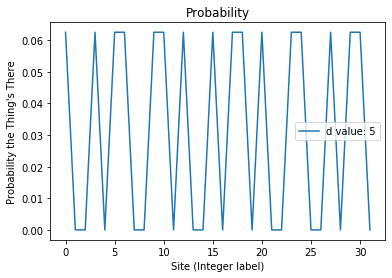

In [109]:
"""
Gimme a sec, gonna just take a look at the graphie here
"""

val = 0
d = [x for x in range(5, 6)]

m = 1000000

vecVal = []
for a in d:
    vecVal.append(intToVec(val, a))

probs = []
for i in range(len(vecVal)):
    res = doMTStep(vecVal[i], d[i], m)
    probs.append(res)
    
#print(probs)

Xs = []
for a in d:
    Xs.append([x for x in range(2**a)])

plt.title("Probability")
for i in range(len(Xs)):
    plt.plot(Xs[i], probs[i], label = "d value: {}".format(d[i]))
plt.xlabel("Site (Integer label)")
plt.ylabel("Probability the Thing's There")
plt.legend()

print("Probability at point 7: {}".format(probs[0][7]))

In [110]:
"""
A million damn tries, still ain't no probability at point 7. There's no way this thing gonna evenly mix.
"""

"\nA million damn tries, still ain't no probability at point 7. There's no way this thing gonna evenly mix.\n"

#### Note this line in our results:

   [0.125 0.    0.    0.125 0.    0.125 0.125 0.    0.    0.125 0.125 0.  0.125 0.    0.    0.125]

[0.    0.125 0.125 0.    0.125 0.    0.    0.125 0.125 0.    0.    0.125  0.    0.125 0.125 0.   ]
 
 #### What this tells us is that it's obscillating between two different sets of positions, with no hope of evenly mixing.
 
 [0.25 0.   0.   0.25 0.   0.25 0.25 0.  ]
 
[0.   0.25 0.25 0.   0.25 0.   0.   0.25]

#### It appears that the hypercube does not allow for even mixing. From everything we can see above, the probabilities very definitively shift between two sets of places repeatedly, for even or odd ds. Actually, this isn't so odd; the matrix is always of even size size the matrix generated is of size 2 to the power of d, which, this rather nicely matches up with the case of the normal 1d random walker who oscillates between even and odd positions all the time for even sizes of the world, never mixing the probabilities onto even and odd positions. Here though we can see it's not even or odd positions; as adjacent positions are very much touched. It's still a similar phenomenon, due to the rules of how it moves though. As such, it scales as infinity for all d in range 2 to 10, and so scales infinitely with any number of sites in the hypercube.